# Install

In [2]:
# !pip install matplotlib
!pip install git+https://github.com/facebookresearch/segment-anything.git

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-_i4x4fcg
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-_i4x4fcg
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36586 sha256=c914fc8b43faad89dfcef89fb089733685d393c742629abc09a5232e9651f9cf
  Stored in directory: /tmp/pip-ephem-wheel-cache-xyob1lja/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything


# Import

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Set-up

In [2]:
setting = True

if setting:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())

PyTorch version: 2.2.1+cu121
Torchvision version: 0.17.1+cu121
CUDA is available: True


In [2]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))  

In [3]:
from segment_anything import sam_model_registry, SamPredictor

# path 설정은 local 환경에 맞게 설정
sam_checkpoint = "../sam_vit_h_4b8939.pth"
model_type = "vit_h"

# if cuda, change it
device = "cuda:0"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

# Inference

In [7]:
image = cv2.imread('truck.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

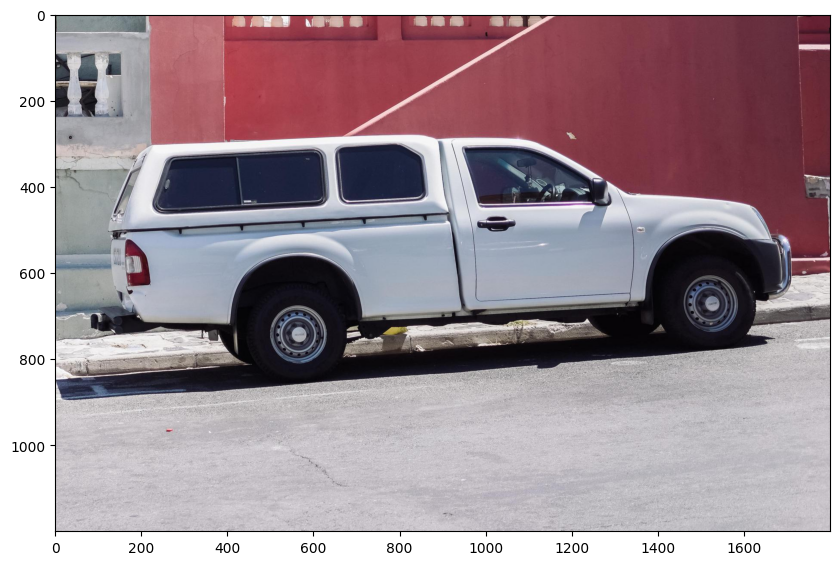

In [8]:
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.axis('on')
plt.show()

# Bbox with SAM

## SAM with real bbox


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_042_07810.jpg: 288x512 1 3, 6.5ms
Speed: 1.3ms preprocess, 6.5ms inference, 1.0ms postprocess per image at shape (1, 3, 288, 512)


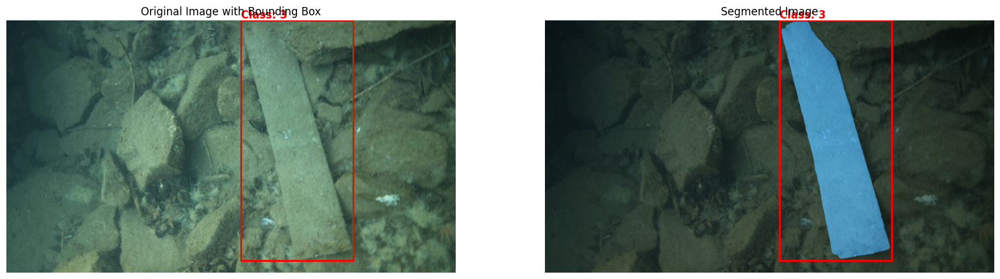


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_044_06198.jpg: 288x512 1 1, 6.3ms
Speed: 1.4ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


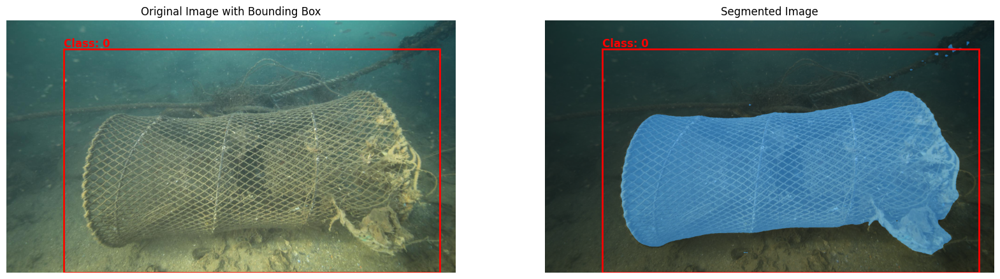


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/fish net_046_03574.jpg: 288x512 1 2, 6.3ms
Speed: 1.5ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


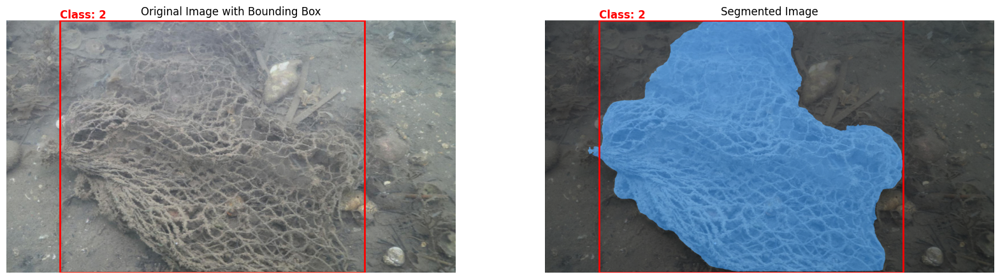


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_046_05587.jpg: 288x512 1 1, 6.3ms
Speed: 1.4ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


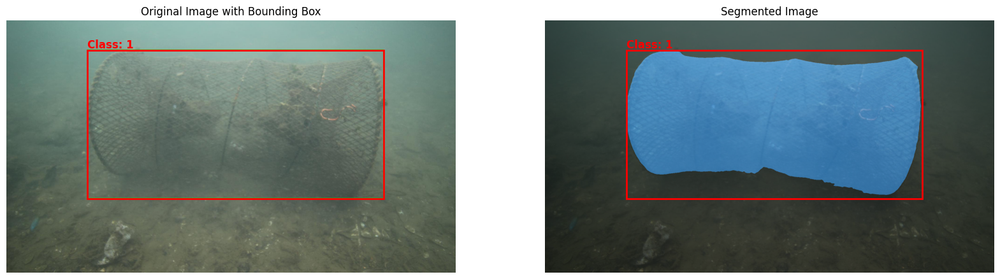


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_029_01721.jpg: 288x512 1 1, 6.4ms
Speed: 1.4ms preprocess, 6.4ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


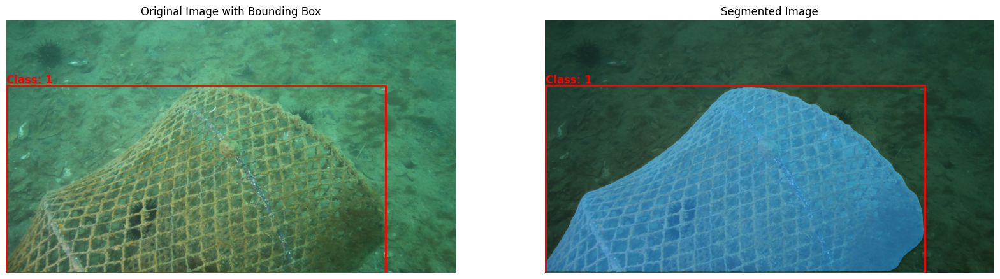


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_048_03659.jpg: 288x512 1 0, 6.3ms
Speed: 1.5ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


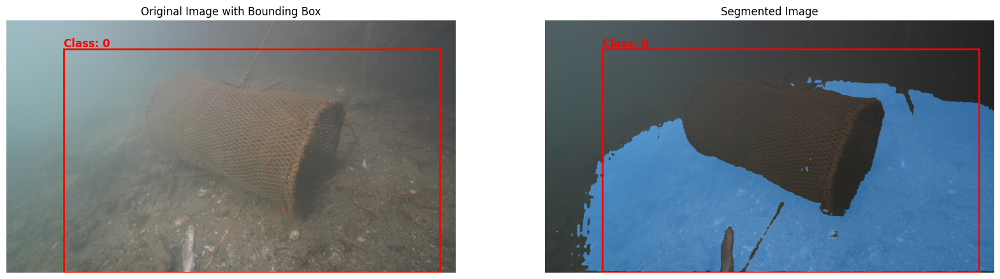


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_046_05742.jpg: 288x512 1 3, 6.3ms
Speed: 1.5ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


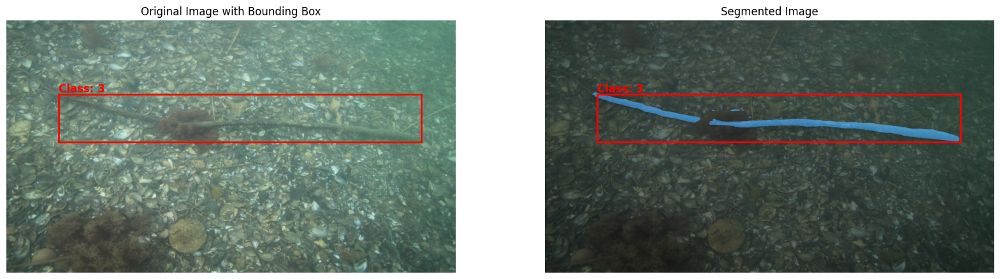


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_042_05431.jpg: 288x512 1 0, 8.2ms
Speed: 2.2ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 288, 512)


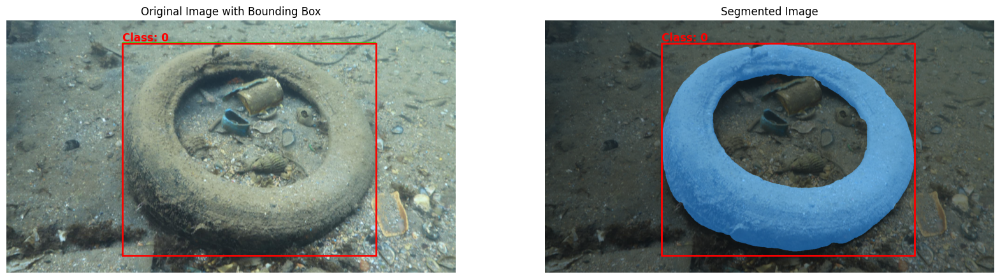


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/eel fish trap_rope_047_01329.jpg: 288x512 1 2, 6.7ms
Speed: 1.6ms preprocess, 6.7ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)


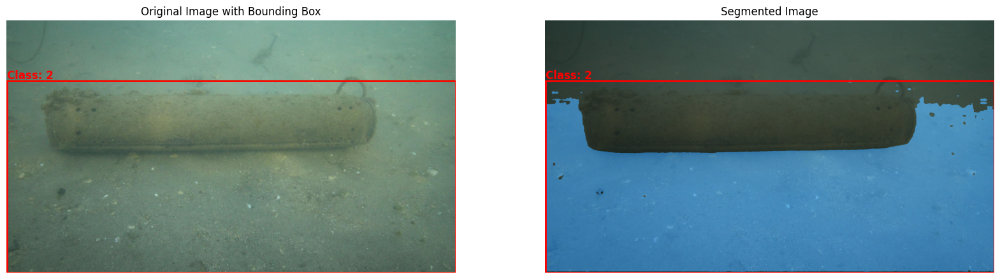


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_047_02499.jpg: 288x512 1 0, 6.3ms
Speed: 1.4ms preprocess, 6.3ms inference, 1.0ms postprocess per image at shape (1, 3, 288, 512)


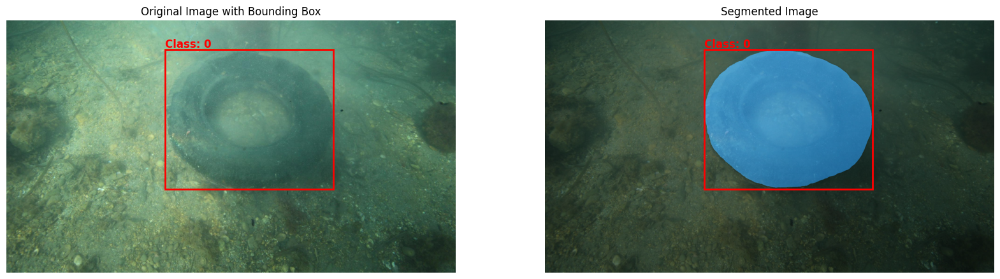

Average Inference Time: 0.0532 seconds


In [8]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from time import time
from ultralytics import YOLO

# Yolov8 형식의 라벨 파일을 읽어 바운딩 박스를 디코딩하는 함수
def read_yolov8_label(label_path, img_width, img_height):
    with open(label_path, 'r') as file:
        lines = file.readlines()
    boxes = []
    for line in lines:
        parts = line.strip().split()
        class_id = int(parts[0])
        x_center = float(parts[1]) * img_width
        y_center = float(parts[2]) * img_height
        width = float(parts[3]) * img_width
        height = float(parts[4]) * img_height
        x1 = x_center - width / 2
        y1 = y_center - height / 2
        x2 = x_center + width / 2
        y2 = y_center + height / 2
        boxes.append((x1, y1, x2, y2, class_id))
    return boxes

# 바운딩 박스 그리는 함수
def draw_bounding_boxes(image, boxes):
    for box in boxes:
        x1, y1, x2, y2, _ = box
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
    return image

# Segmentation Mask를 시각화하는 함수
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.random.random(3)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image, alpha=0.5)

# 바운딩 박스를 시각화하는 함수
def show_box(box, ax):
    x1, y1, x2, y2, class_id = box
    ax.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, edgecolor='red', linewidth=2))
    ax.text(x1, y1 - 10, f'Class: {class_id}', color='red', fontsize=12, fontweight='bold')

# Yolov8 모델 초기화
best_model = YOLO('../data/runs/detect/train/weights/best.pt')

# 예측할 이미지 수 설정
num_images = 10

# test 이미지 및 라벨 경로
image_dir = '/home/team1/ddrive/team1/DL/DL_Programming/data/test/images'
label_dir = '/home/team1/ddrive/team1/DL/DL_Programming/data/test/labels'

image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.jpg')][:num_images]

# 추론 시간 측정을 위한 변수 초기화
total_inference_time = 0

# 반복문을 통해 각 이미지 예측 및 세그멘테이션 수행
for image_file in image_files:
    image_name = os.path.basename(image_file)
    label_name = os.path.splitext(image_name)[0] + '.txt'
    label_path = os.path.join(label_dir, label_name)

    # 이미지 예측
    start_time = time()
    results = best_model.predict(source=image_file, save=False, imgsz=(512, 512))
    end_time = time()

    total_inference_time += end_time - start_time

    for result in results:
        # 이미지 로드 및 RGB 변환
        image = cv2.imread(result.path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Yolov8 라벨 파일에서 바운딩 박스 읽기
        img_height, img_width, _ = image.shape
        boxes = read_yolov8_label(label_path, img_width, img_height)

        # 각 바운딩 박스를 SAM을 통해 세그멘테이션
        for box in boxes:
            input_box = np.array(box[:4])

            predictor.set_image(image_rgb)

            masks, _, _ = predictor.predict(
                point_coords=None,
                point_labels=None,
                box=input_box[None, :],
                multimask_output=False,
            )

            # 원본 이미지에 바운딩 박스 그리기
            image_with_boxes = draw_bounding_boxes(image.copy(), [box])

            # 시각화
            fig, axs = plt.subplots(1, 2, figsize=(20, 10))

            # 좌측: 원본 이미지와 바운딩 박스
            axs[0].imshow(cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB))
            show_box(box, axs[0])
            axs[0].set_title('Original Image with Bounding Box')
            axs[0].axis('off')

            # 우측: Segmentation 된 이미지
            axs[1].imshow(image_rgb)
            show_mask(masks[0], axs[1])
            show_box(box, axs[1])
            axs[1].set_title('Segmented Image')
            axs[1].axis('off')

            plt.show()

# 평균 추론 시간 계산
average_inference_time = total_inference_time / num_images
print(f"Average Inference Time: {average_inference_time:.4f} seconds")


## SAM with yolov8 bbox


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_042_07810.jpg: 288x512 1 3, 7.8ms
Speed: 1.6ms preprocess, 7.8ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_042_07810.jpg
Class: tensor([3.], device='cuda:0'), Confidence: tensor([0.8503], device='cuda:0'), Bbox: tensor([[ 994.2432,    7.7142, 1481.0460, 1069.2010]], device='cuda:0')


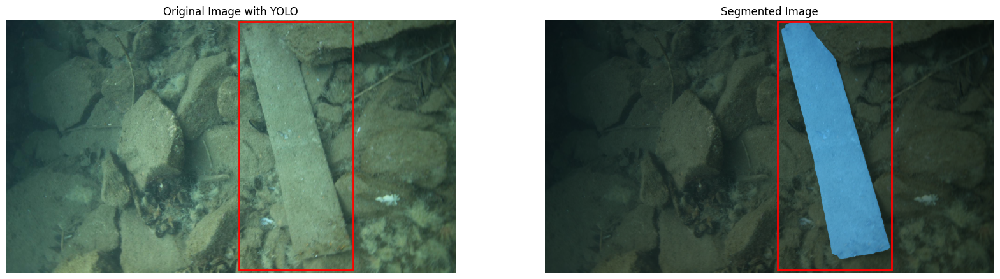


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_044_06198.jpg: 288x512 1 1, 7.9ms
Speed: 1.7ms preprocess, 7.9ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_044_06198.jpg
Class: tensor([1.], device='cuda:0'), Confidence: tensor([0.7070], device='cuda:0'), Bbox: tensor([[ 317.1819,  308.1498, 1779.6315,  972.7897]], device='cuda:0')


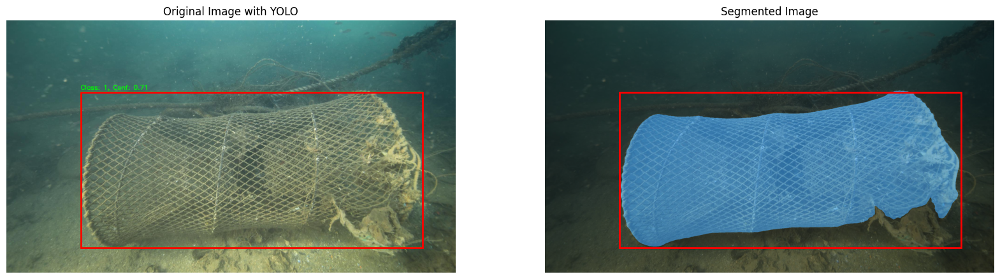


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/fish net_046_03574.jpg: 288x512 1 2, 6.3ms
Speed: 1.5ms preprocess, 6.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/fish net_046_03574.jpg
Class: tensor([2.], device='cuda:0'), Confidence: tensor([0.8992], device='cuda:0'), Bbox: tensor([[ 232.6720,  133.0931, 1541.8624, 1080.0000]], device='cuda:0')


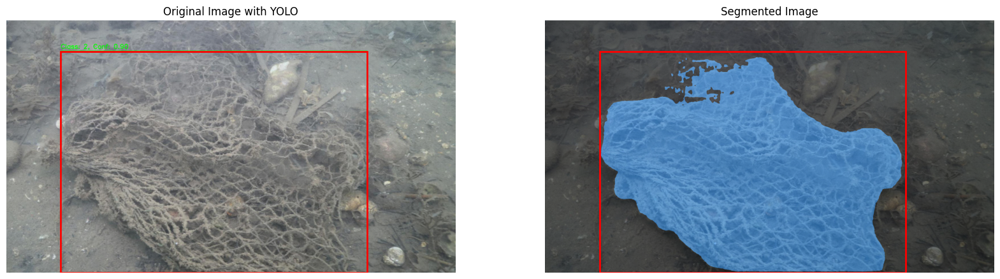


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_046_05587.jpg: 288x512 1 1, 8.2ms
Speed: 2.3ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_046_05587.jpg
Class: tensor([1.], device='cuda:0'), Confidence: tensor([0.9415], device='cuda:0'), Bbox: tensor([[ 340.4783,  129.4632, 1613.9381,  759.5502]], device='cuda:0')


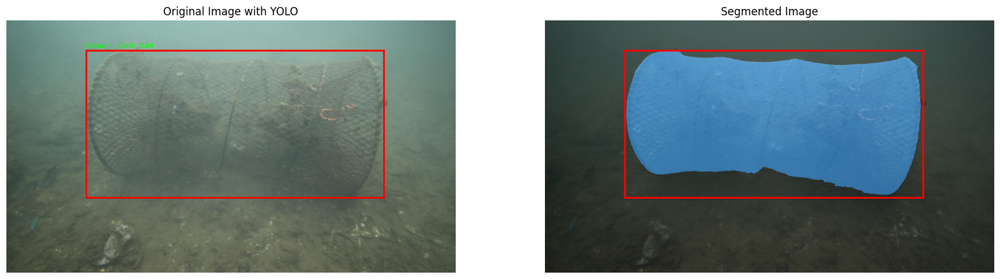


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_029_01721.jpg: 288x512 1 1, 7.2ms
Speed: 1.4ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_029_01721.jpg
Class: tensor([1.], device='cuda:0'), Confidence: tensor([0.8920], device='cuda:0'), Bbox: tensor([[   6.4098,  273.4538, 1638.1564, 1080.0000]], device='cuda:0')


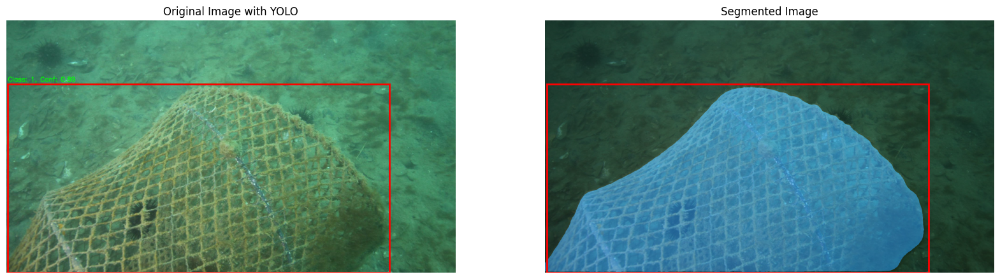


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_048_03659.jpg: 288x512 1 0, 7.8ms
Speed: 2.2ms preprocess, 7.8ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/spring fish trap_rope_048_03659.jpg
Class: tensor([0.], device='cuda:0'), Confidence: tensor([0.7507], device='cuda:0'), Bbox: tensor([[ 439.6389,   14.3560, 1724.2301,  924.4791]], device='cuda:0')


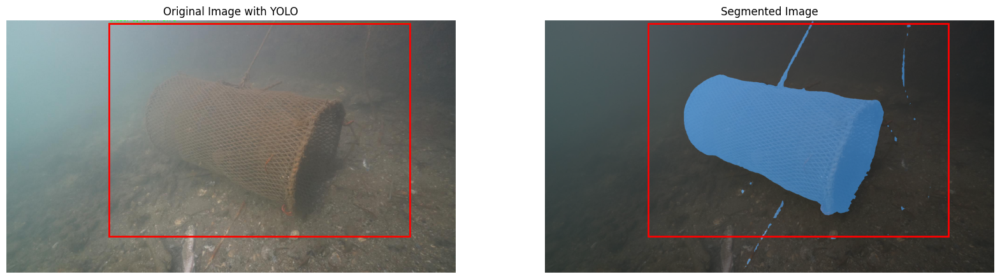


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_046_05742.jpg: 288x512 1 3, 6.4ms
Speed: 1.4ms preprocess, 6.4ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/wood_046_05742.jpg
Class: tensor([3.], device='cuda:0'), Confidence: tensor([0.2871], device='cuda:0'), Bbox: tensor([[ 647.4828,  399.8071, 1822.2639,  527.1715]], device='cuda:0')


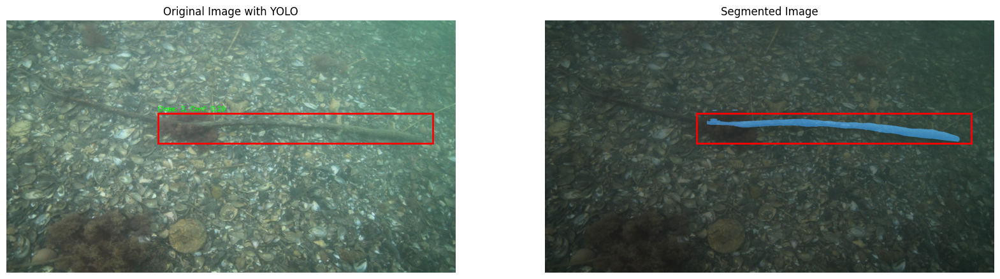


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_042_05431.jpg: 288x512 1 0, 7.9ms
Speed: 1.5ms preprocess, 7.9ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_042_05431.jpg
Class: tensor([0.], device='cuda:0'), Confidence: tensor([0.8755], device='cuda:0'), Bbox: tensor([[ 505.6689,  101.2990, 1582.5262, 1009.3908]], device='cuda:0')


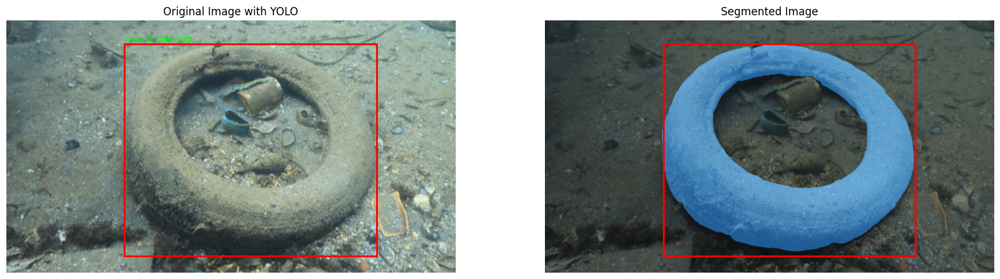


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/eel fish trap_rope_047_01329.jpg: 288x512 1 2, 7.7ms
Speed: 1.5ms preprocess, 7.7ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/eel fish trap_rope_047_01329.jpg
Class: tensor([2.], device='cuda:0'), Confidence: tensor([0.4620], device='cuda:0'), Bbox: tensor([[ 404.7039,  281.4441, 1475.4005,  783.4525]], device='cuda:0')


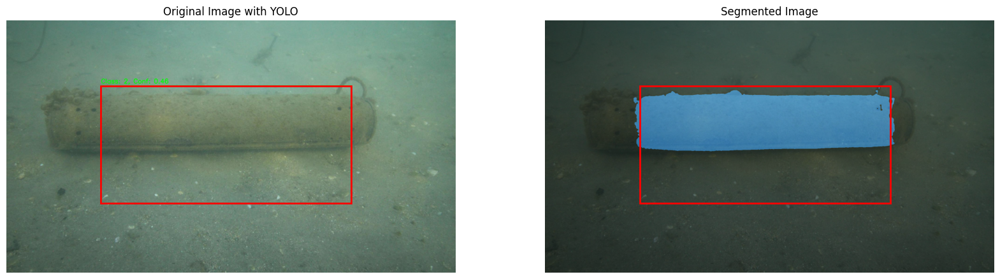


image 1/1 /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_047_02499.jpg: 288x512 1 0, 7.4ms
Speed: 1.5ms preprocess, 7.4ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 512)
Image: /home/team1/ddrive/team1/DL/DL_Programming/data/test/images/tire_047_02499.jpg
Class: tensor([0.], device='cuda:0'), Confidence: tensor([0.9682], device='cuda:0'), Bbox: tensor([[ 674.9142,  123.3109, 1402.2300,  709.2543]], device='cuda:0')


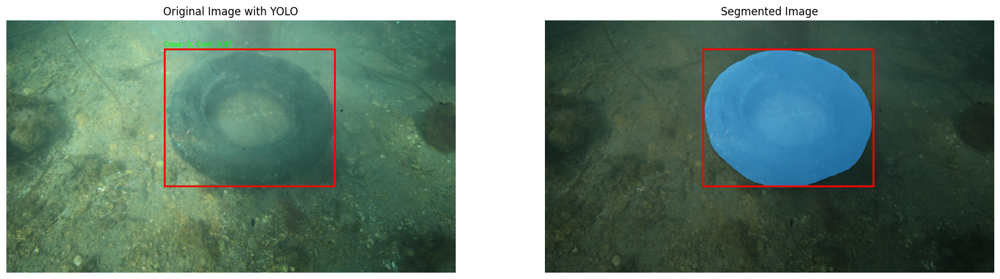

In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

# 바운딩 박스 그리는 함수
def draw_bounding_boxes(image, boxes):
    for box in boxes:
        x_min, y_min, x_max, y_max = map(int, box.xyxy[0])
        class_id = int(box.cls[0])
        confidence = float(box.conf[0])

        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
        cv2.putText(image, f'Class: {class_id}, Conf: {confidence:.2f}', 
                    (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, 
                    (0, 255, 0), 2)
    
    return image

# Segmentation Mask를 시각화하는 함수
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.random.random(3)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image, alpha=0.5)

# 바운딩 박스를 시각화하는 함수
def show_box(box, ax):
    x0, y0, x1, y1 = box
    ax.add_patch(plt.Rectangle((x0, y0), x1 - x0, y1 - y0, fill=False, edgecolor='red', linewidth=2))

# Yolov8 모델 초기화
best_model = YOLO('../data/runs/detect/train/weights/best.pt')

# 예측할 이미지 수 설정
num_images = 10

# test 이미지 경로
image_dir = '/home/team1/ddrive/team1/DL/DL_Programming/data/test/images'
image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.jpg')][:num_images]

# 반복문을 통해 각 이미지 예측 및 세그멘테이션 수행
for image_file in image_files:
    # 이미지 예측
    results = best_model.predict(source=image_file, save=False, imgsz=(512, 512))

    for result in results:
        print(f"Image: {result.path}")
        for box in result.boxes:
            print(f"Class: {box.cls}, Confidence: {box.conf}, Bbox: {box.xyxy}")

        # 이미지 로드 및 RGB 변환
        image = cv2.imread(result.path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # 각 바운딩 박스를 SAM을 통해 세그멘테이션
        for box in result.boxes:
            x_min, y_min, x_max, y_max = map(int, box.xyxy[0])
            input_box = np.array([x_min, y_min, x_max, y_max])

            predictor.set_image(image_rgb)

            masks, _, _ = predictor.predict(
                point_coords=None,
                point_labels=None,
                box=input_box[None, :],
                multimask_output=False,
            )

            # 원본 이미지에 바운딩 박스 그리기
            image_with_boxes = draw_bounding_boxes(image.copy(), result.boxes)

            # 시각화
            fig, axs = plt.subplots(1, 2, figsize=(20, 10))

            # 좌측: 원본 이미지와 바운딩 박스
            axs[0].imshow(cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB))
            show_box(input_box, axs[0])
            axs[0].set_title('Original Image with YOLO')
            axs[0].axis('off')

            # 우측: Segmentation 된 이미지
            axs[1].imshow(image_rgb)
            show_mask(masks[0], axs[1])
            show_box(input_box, axs[1])
            axs[1].set_title('Segmented Image')
            axs[1].axis('off')

            plt.show()
